#### TC count , Vmax of each TC and Lat of Vmax  time sereis (annual) of IBTrACS and LENS2 and HR
- 1 Australia
    - IBTrACS
    - LENS2
    - HR 
- 2 East Australia
    - IBTrACS
    - LENS2
    - HR 
- 3 West Australia
    - IBTrACS
    - LENS2
    - HR 
- 4 New Zealand
    - IBTrACS
    - LENS2
    - HR<br>
Ming Ge Aug; 2024

In [1]:
import glob
import datetime  
import numpy as np
import pandas as pd

import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from mpl_toolkits.basemap import Basemap
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import matplotlib.colors as co
from matplotlib.lines import Line2D  
import matplotlib.cm as cm
from matplotlib.colors import BoundaryNorm, ListedColormap
from matplotlib.collections import LineCollection

In [2]:
# timeseries graph with trendline
def ts_trendline(df, var_s):
    plt.figure(figsize=(6, 4), dpi=300)
    x = df.index
    x = mdates.date2num(df.index)

    y = df[var_s].tolist()
    z = np.polyfit(x,y,1)
    p = np.poly1d(z)
    plt.plot(df.index, p(x), "g--")
    plt.plot(df.index, df[var_s])
    plt.ylabel(var_s)
    plt.show()
    

In [3]:
def ts_trendline_en(year_s, year_e, data_3d):
    
    var_s = ['TC Count', 'Vmax', 'Lat of Vmax']
    n_var = len(var_s)
    xx = range(year_s, year_e+1)

    for nv in range(n_var):
        plt.figure(figsize=(6, 4), dpi=300)
        # plot all memebers
        plt.plot(xx, np.transpose(data_3d[:,:,nv]), linewidth=0.5, color='grey', alpha=0.3)

        # plot ensemble mean
        yy_avg = np.nanmean(data_3d[:,:, nv], axis=0)
        yy_std = np.nanstd(data_3d[:,:, nv], axis=0)
        plt.plot(xx, yy_avg, linewidth=2.0)
        plt.fill_between(xx, yy_avg-yy_std, yy_avg + yy_std, alpha=0.3)

        # plot trend
        yy = yy_avg.tolist()
        zz = np.polyfit(xx,yy,1)
        pp = np.poly1d(zz)
        plt.plot(xx, pp(xx),  linewidth=2)
     
        plt.ylabel(var_s[nv])
        plt.show()
        

In [4]:
def rd_IB_info(year_s, year_e, extent, is_plot):
    '''
    get DataFrame TC count,  Vmax of each TC and Latitude of Vmax of IBTrACS
    '''
    delta = 5
    lon_s = extent[0]
    lon_e = extent[1]
    lat_s = extent[2]
    lat_e = extent[3]
    flnm_ib = '/glade/work/mingge/TC_DBS/IBTrACS.ALL.v04r00.nc'
    ds = xr.open_dataset(flnm_ib)

    lat = ds.usa_lat.data
    lon = ds.usa_lon.data
    wind10 = ds.usa_wind.data
    stormYear = ds.season.data  # year based on season'

    is_plotting = True

    if is_plotting == True:
        plt.figure(figsize=(10, 4), dpi=dpi)
        ax = plt.axes(projection=proj)
        ax.coastlines()
        # Manipulate gridlines number and spaces
        ax.set_xticks(range(lon_s, lon_e + delta, delta),crs=ccrs.PlateCarree())
        ax.set_xticklabels(range(lon_s, lon_e + delta, delta), color='black')
        ax.set_yticks(range(lat_s, lat_e + delta, delta), crs=ccrs.PlateCarree())
        ax.set_yticklabels(range(lat_s, lat_e + delta, delta), color='black')
        ax.grid(linewidth=.2, color='black', alpha=0.5, linestyle='--')
        # West Pacific
        ax.set_extent(extent) 
        ax.set_ylim(lat_s, lat_e) 
        ax.add_feature(cfeature.OCEAN, facecolor='white')
        ax.set_title('IBTrACS from' + str(year_s) + '-' + str(year_e))
        ax.add_feature(cfeature.LAND, edgecolor='white')

    n_year = year_e - year_s + 1
    tc_count = np.zeros((n_year)) 
    vmax_1d  = np.zeros((n_year)) 
    lat_vmax = np.zeros((n_year)) 

    for year in range(year_s, year_e +1):
        tcmask = np.where((stormYear == year))
                    
        latselect = lat[tcmask]
        lonselect = lon[tcmask]
        spdselect = wind10[tcmask]
    
        n_tc = len(latselect)
    
        for ii in range(n_tc):
            spd_all = np.array(spdselect[ii,:])
            spd_1d  = spd_all[~np.isnan(spd_all)]
        
            lat_1d = np.array(latselect[ii,:]) 
            lat_1d = lat_1d[~np.isnan(spd_all)]
        
            lon_1d = np.array(lonselect[ii,:]) 
            lon_1d = lon_1d[~np.isnan(spd_all)]
            lon_1d =np.where(lon_1d < 0, lon_1d+360, lon_1d)
            latmask = np.where((lat_1d>lat_s) & (lat_1d < lat_e))
        
            if(len(latmask[0]) !=0):
                lat_latmask = lat_1d[latmask]               
                lon_latmask = lon_1d[latmask]  
                spd_latmask = spd_1d[latmask] 
            
                lonmask = np.where((lon_latmask>lon_s) & (lon_latmask < lon_e))
                if(len(lonmask[0]) !=0):
                    lat_final = lat_latmask[lonmask]
                    lon_final = lon_latmask[lonmask]
                    spd_final = spd_latmask[lonmask]

                    # find location of Vmax
                    argmax_ind = np.argmax(spd_final)
                
                    tc_count[year-year_s] += 1
                    vmax_1d [year-year_s] = np.max(spd_final)
                    lat_vmax[year-year_s] = lat_final[argmax_ind]
                
                    if is_plotting == True:
                        lon_final = lon_final - lon_cen
                 
                        lonlat = np.stack([lon_final, lat_final], axis=-1)
                        segments = np.stack([lonlat[:-1], lonlat[1:]], axis=1)
        
                        line_collection = LineCollection(segments, cmap=cmap, norm=norm, 
                                         linewidths=.3, linestyle='-')
                        # Set the value array from spd_1d, The values that are mapped to colors.
                        line_collection.set_array(spd_1d)
 
                        ax.add_collection(line_collection)    
            
    if is_plotting == True: 
        leg_lines = [Line2D([0], [0], color=CAT_COLORS[i_col], lw=2)
                for i_col in range(len(SAFFIR_SIM_CAT))]
        leg_names = [CAT_NAMES[i_col] for i_col in sorted(CAT_NAMES.keys())]

        ax.legend(leg_lines, leg_names, fontsize= 5, loc='lower left')
 
    # create a time series dataframe from a 1D numpy array
    # Define a time index
    periods = n_year  # Number of periods should match the length of the data array
    time_index = pd.date_range(start = str(year_s) + '-01-01', end=str(year_e+1)+'-01-01', freq='A')

    data = np.zeros((n_year, 3))
    data[:,0] = tc_count
    data[:,1] = vmax_1d
    data[:,2] = lat_vmax
    
    # Create DataFrame
    df = pd.DataFrame(data, index=time_index, columns=['TC Count', 'Vmax', 'Lat of Vmax'])

    return df

In [5]:
def rd_HR_info(dir_hr, year_s, year_e, extent):
    
    lon_s = extent[0]
    lon_e = extent[1]
    lat_s = extent[2]
    lat_e = extent[3]
    n_year = year_e - year_s + 1
    
    dirs = [ff for ff in glob.glob(dir_hr + "*")]
    n_mem = len(dirs)

    tc_count = np.zeros((n_year)) 
    vmax_1d  = np.zeros((n_year)) ; vmax_1d[:] = np.nan
    lat_vmax = np.zeros((n_year)) ; lat_vmax[:] = np.nan
    data_3d = np.zeros((n_mem, n_year, 3))

    nm = 0
    for dir in dirs:
        tc_count[:] = 0
        for year in range(year_s, year_e + 1):
            name = dir[len(dir_hr) + 8:-4]        
            flnm = dir + '/' + 'CESM_HR_TC_'+ name+'_output_' + str(year) + '_SH.txt'
         
            df_tc = pd.read_csv(flnm, delimiter=', ', engine='python')
            df = df_tc.loc[df_tc['year'].astype(int) == year]
            tc_ids = np.unique(df.track_id.astype(int))
        
            for tc_id in tc_ids:
                df_single = df.loc[df.track_id.astype(int) == tc_id]
             
                lat_1d = df_single.lat.values.astype(float) 
                lon_1d = df_single.lon.values.astype(float) 
                spd_1d = df_single.wind10.values.astype(float)/kt2ms 
            
                lon_1d =np.where(lon_1d < 0, lon_1d+360, lon_1d)

                latmask = np.where((lat_1d>lat_s) & (lat_1d < lat_e))
        
                if(len(latmask[0]) !=0):
                    lat_latmask = lat_1d[latmask]               
                    lon_latmask = lon_1d[latmask]  
                    spd_latmask = spd_1d[latmask] 
            
                    lonmask = np.where((lon_latmask>lon_s) & (lon_latmask < lon_e))
                    if(len(lonmask[0]) !=0):
                        lat_final = lat_latmask[lonmask]
                        lon_final = lon_latmask[lonmask]
                        spd_final = spd_latmask[lonmask]

                        # find location of Vmax
                        argmax_ind = np.argmax(spd_final)
                
                        tc_count[year-year_s] += 1
                        vmax_1d [year-year_s] = np.max(spd_final)
                        lat_vmax[year-year_s] = lat_final[argmax_ind]

        data = np.zeros((n_year, 3))
        data_3d[nm, :,0] = tc_count
        data_3d[nm, :,1] = vmax_1d
        data_3d[nm, :,2] = lat_vmax
    
        nm = nm + 1

    return data_3d

In [6]:
def rd_LENS2_info(dir_lens2, year_s, year_e, extent):
    
    lon_s = extent[0]
    lon_e = extent[1]
    lat_s = extent[2]
    lat_e = extent[3]
    n_year = year_e - year_s + 1

    flnms = [ff for ff in sorted(glob.glob(dir_lens2 + "*WeakThreshold.txt"))]
    n_mem = len(flnms)

    tc_count = np.zeros((n_year)) 
    vmax_1d  = np.zeros((n_year)) ; vmax_1d[:] = np.nan
    lat_vmax = np.zeros((n_year)) ; lat_vmax[:] = np.nan 
    data_3d = np.zeros((n_mem, n_year, 3))

    nm = 0
    for flnm in flnms:
        tc_count[:] = 0
        df_tc = pd.read_csv(flnm, delimiter=', ', engine='python')
        # drop rows containing 'year' in column year
        df_tc = df_tc[~df_tc.year.str.contains("year")]
        for year in range(year_s, year_e + 1):
            df = df_tc.loc[df_tc['year'].astype(int) == year]
            tc_ids = np.unique(df.track_id.astype(int))
            # 29
            for tc_id in tc_ids:
                df_single = df.loc[df.track_id.astype(int) == tc_id]
             
                lat_1d = df_single.lat.values.astype(float) 
                lon_1d = df_single.lon.values.astype(float) 
                spd_1d = df_single.wind10.values.astype(float)/kt2ms 
            
                lon_1d =np.where(lon_1d < 0, lon_1d+360, lon_1d)

                latmask = np.where((lat_1d>lat_s) & (lat_1d < lat_e))
        
                if(len(latmask[0]) !=0):
                    lat_latmask = lat_1d[latmask]               
                    lon_latmask = lon_1d[latmask]  
                    spd_latmask = spd_1d[latmask] 
            
                    lonmask = np.where((lon_latmask>lon_s) & (lon_latmask < lon_e))
                    if(len(lonmask[0]) !=0):
                        lat_final = lat_latmask[lonmask]
                        lon_final = lon_latmask[lonmask]
                        spd_final = spd_latmask[lonmask]

                        # find location of Vmax
                        argmax_ind = np.argmax(spd_final)
                
                        tc_count[year-year_s] += 1
                        vmax_1d [year-year_s] = np.max(spd_final)
                        lat_vmax[year-year_s] = lat_final[argmax_ind]

        data = np.zeros((n_year, 3))
        data_3d[nm, :,0] = tc_count
        data_3d[nm, :,1] = vmax_1d
        data_3d[nm, :,2] = lat_vmax
        nm += 1
    return data_3d

#### Setup

In [7]:
dir_plot  = '/glade/campaign/mmm/c3we/mingge/TC/PLOT/'
dir_lens2 = '/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/'
dir_hr    = '/glade/campaign/mmm/c3we/done/pcast/CESM_HR/'

dpi = 250

kt2ms = 0.514444
ms2kt = 1.94384

cat_name   = ['TD', 'TS', 'HU1', 'HU2', 'HU3', 'HU4','HU5']
cat_thresh = np.array([34.,   63.,   82.,   95.,   112., 136.])
colors = {'TD': 'blue', 
          'TS': 'green', 
          'HU1': 'cyan', 
          'HU2': 'gold', 
          'HU3': 'coral', 
          'HU4': 'crimson',
          'HU5': 'brown'}

CAT_NAMES = {
    -1: 'TD',
    0: 'TS',
    1: 'HU1',
    2: 'HU2',
    3: 'HU3',
    4: 'HU4',
    5: 'HU5'}

SAFFIR_SIM_CAT = [34, 64, 83, 96, 113, 137, 1000]
norm = BoundaryNorm([0] + SAFFIR_SIM_CAT, len(SAFFIR_SIM_CAT))
CAT_COLORS = cm.inferno(np.linspace(0, 1, len(SAFFIR_SIM_CAT)))
CAT_COLORS = cm.rainbow(np.linspace(0, 1, len(SAFFIR_SIM_CAT)))
cmap = ListedColormap(colors=CAT_COLORS)


#### 1 Australia
- 1.1 IBTrACS 

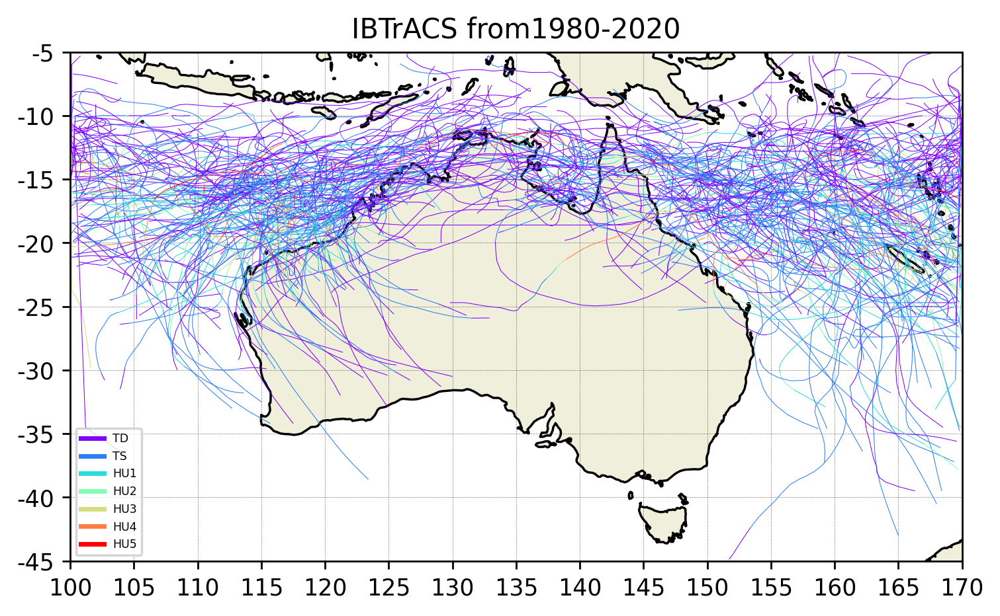

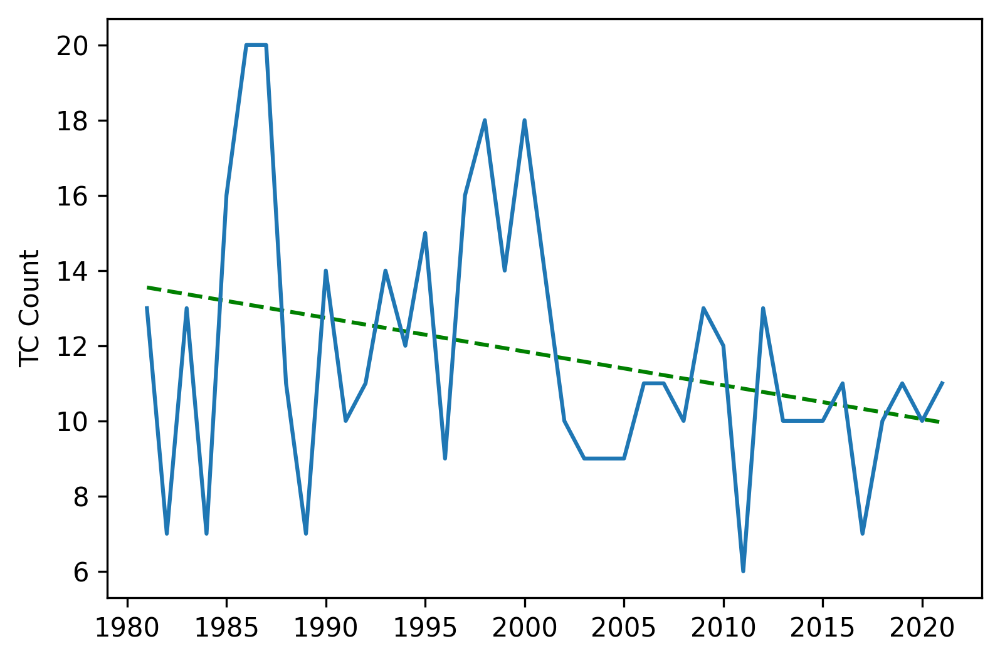

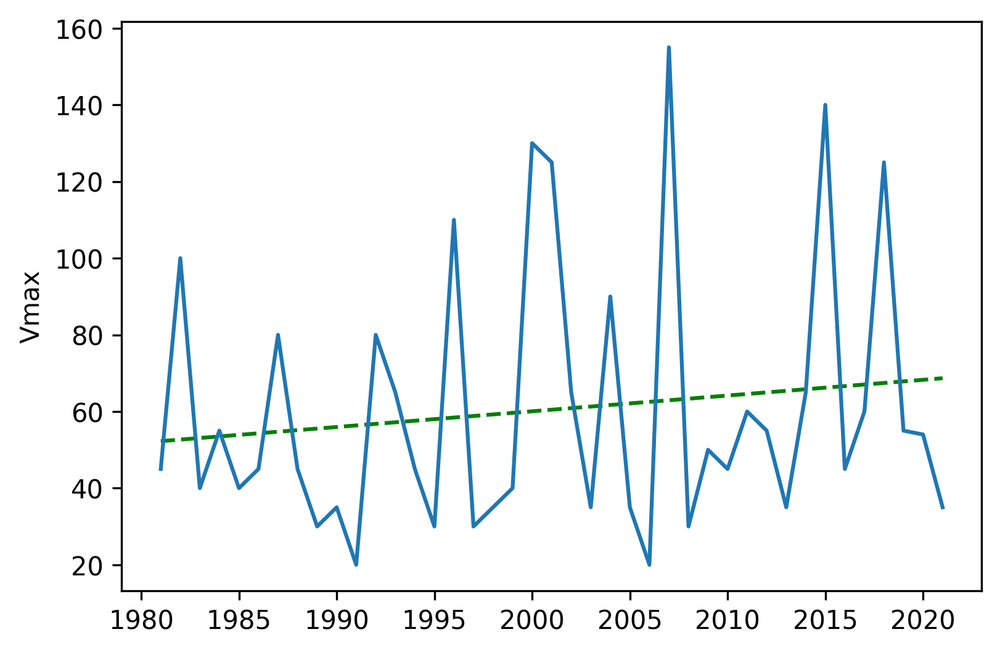

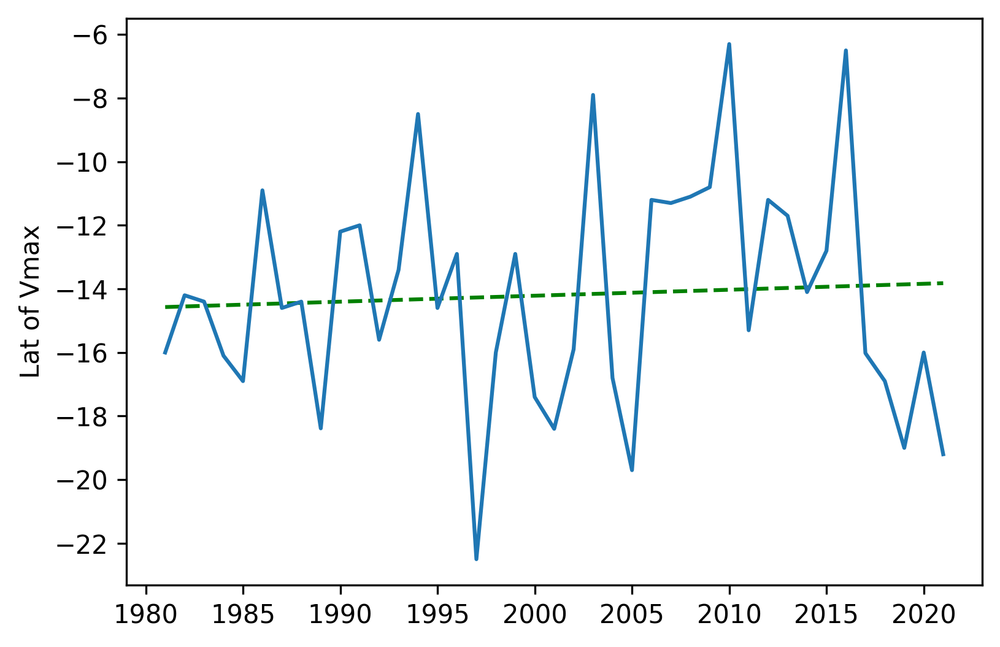

In [8]:
year_s = 1980
#year_s = 2020
year_e = 2020
n_year = year_e - year_s + 1

# OZ
lon_s = 100
lon_e = 170
lat_s = -45
lat_e = -5

lon_cen = (lon_s+lon_e)*0.5
proj    = ccrs.PlateCarree(central_longitude=lon_cen)
extent = [lon_s, lon_e, lat_s, lat_e]

df = rd_IB_info(year_s, year_e, extent, True)
ts_trendline(df, 'TC Count')
ts_trendline(df, 'Vmax')
ts_trendline(df, 'Lat of Vmax')

- 1.2 LENS2 HR

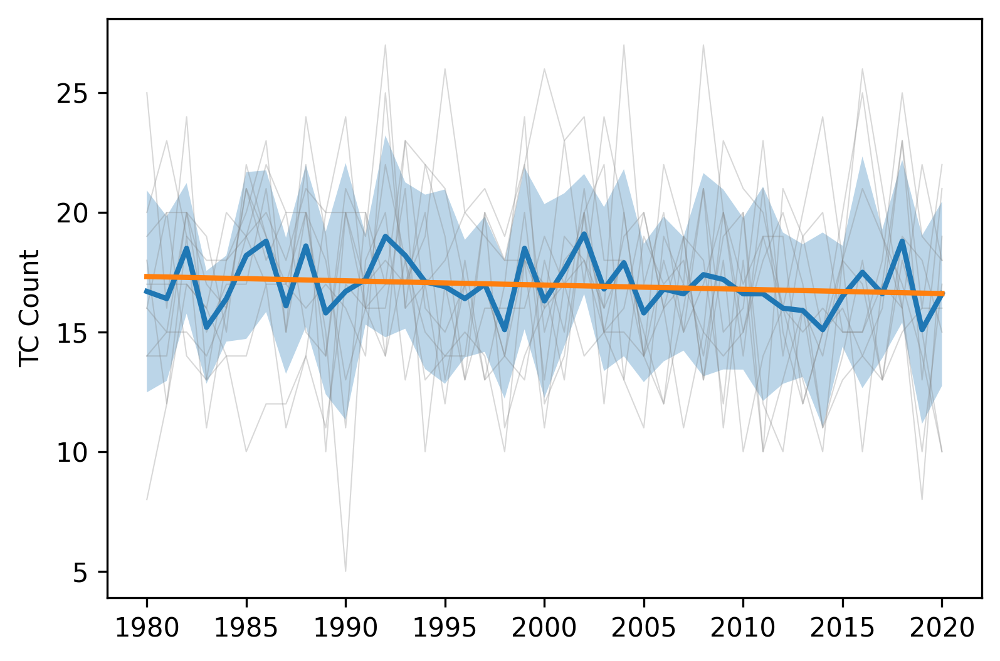

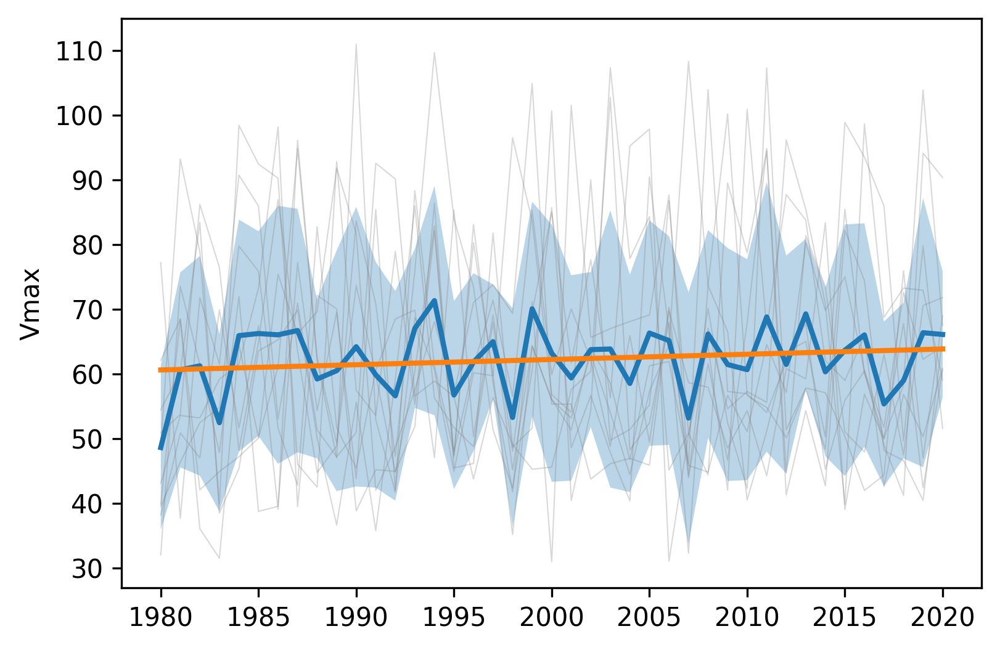

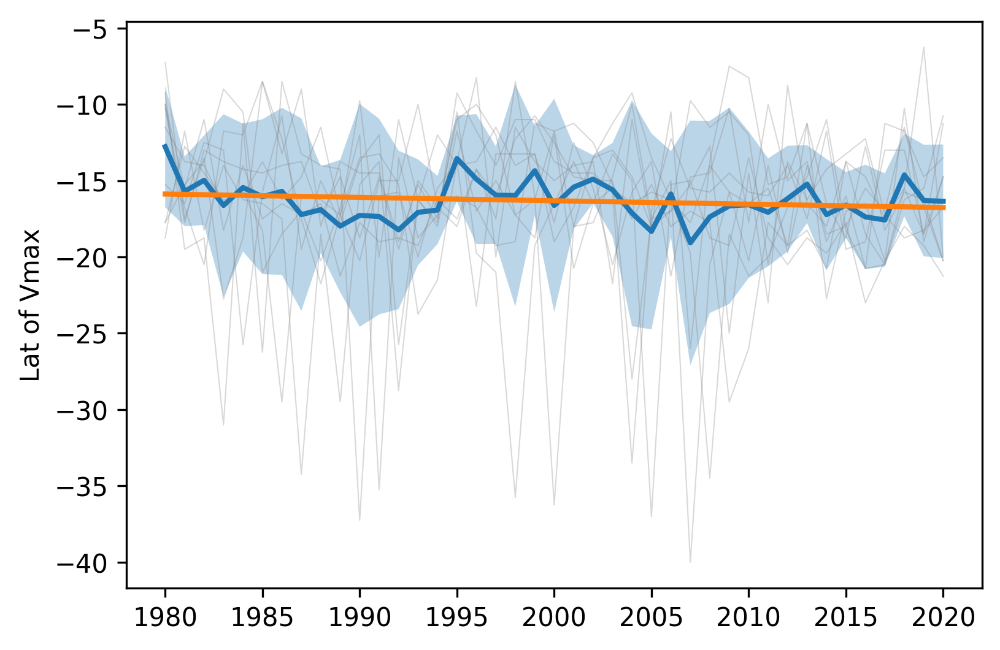

In [9]:
data_3d = rd_HR_info(dir_hr, year_s, year_e, extent) 
ts_trendline_en(year_s, year_e, data_3d) 

- 1.3 LENS2 WeakThreshold 100 member

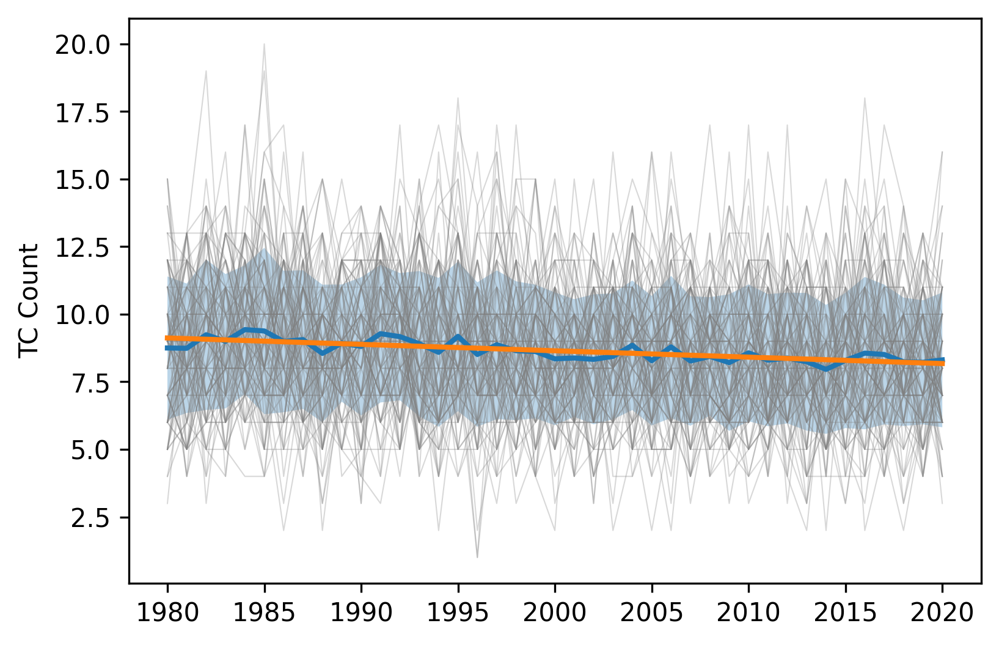

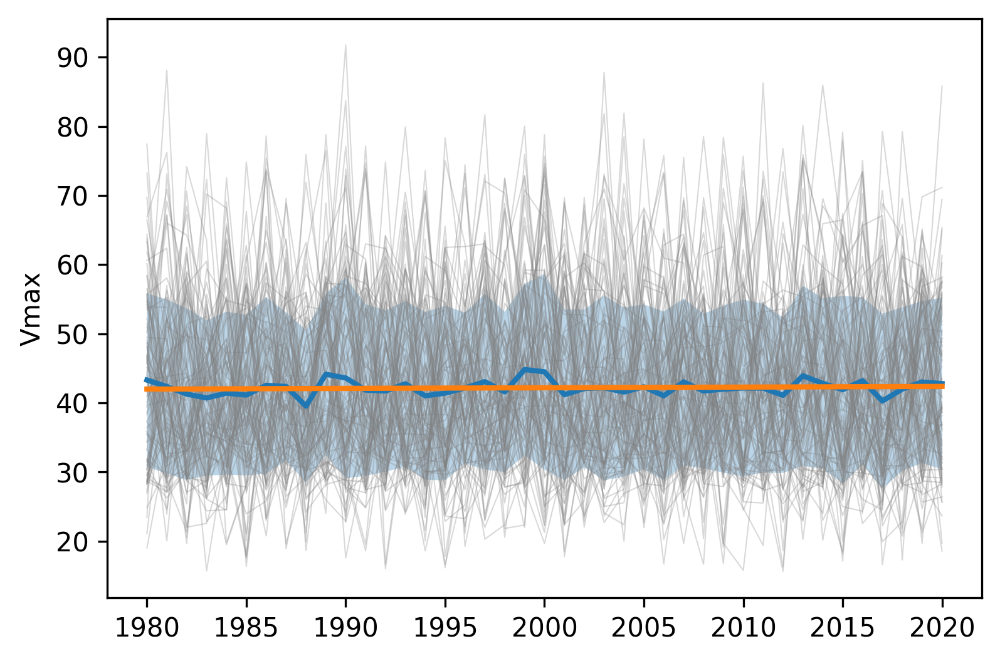

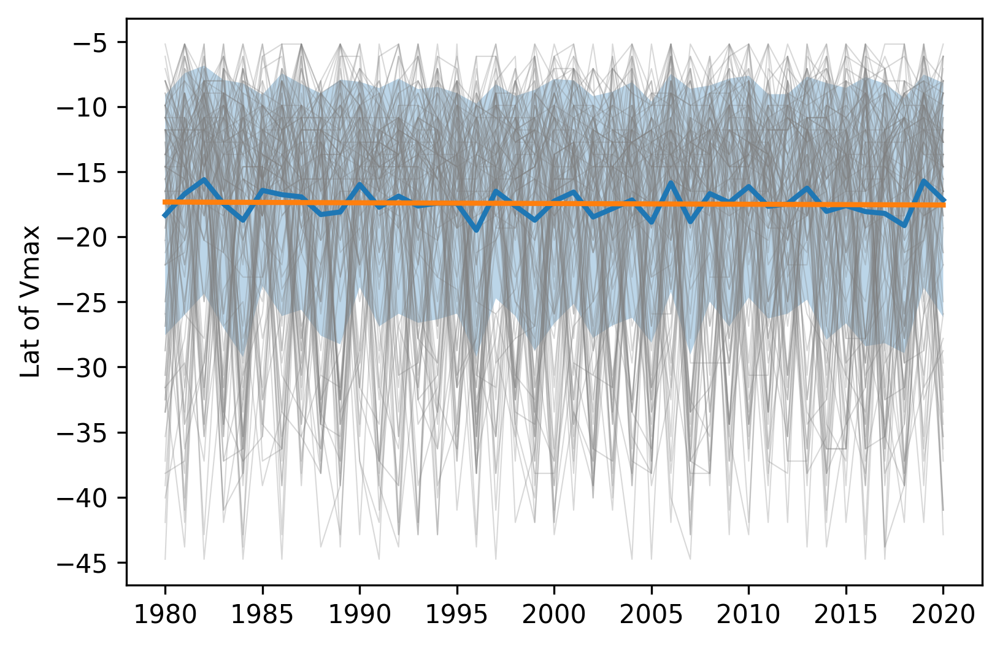

In [10]:
data_3d = rd_LENS2_info(dir_lens2, year_s, year_e, extent)
ts_trendline_en(year_s, year_e, data_3d)

#### 2 East Australia

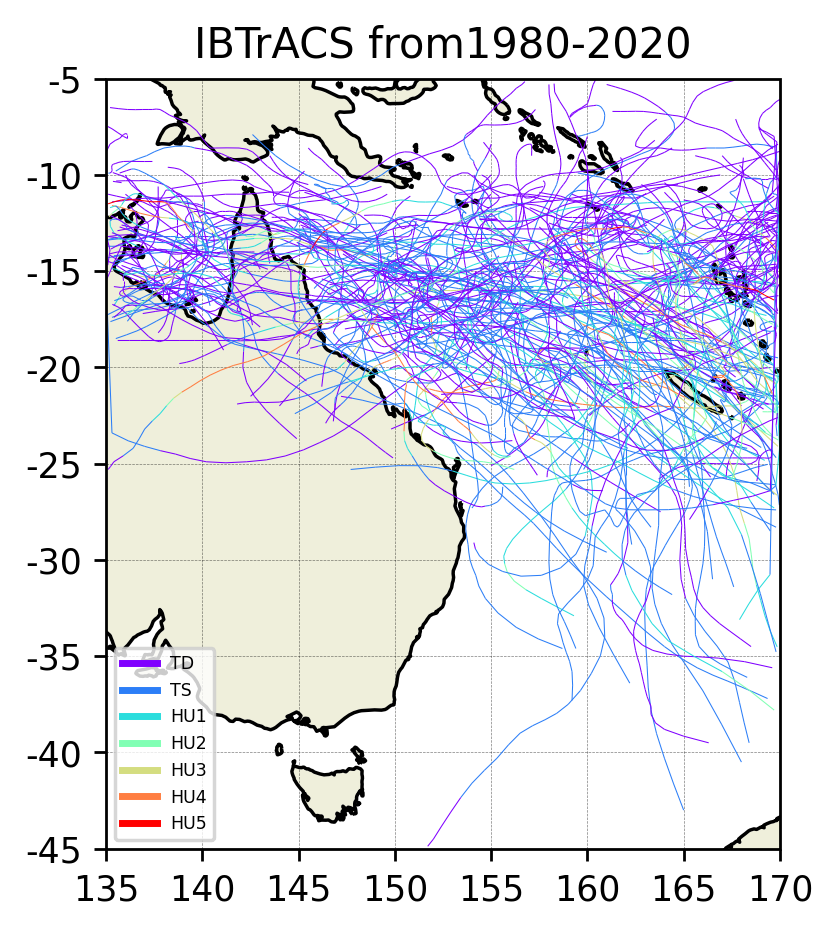

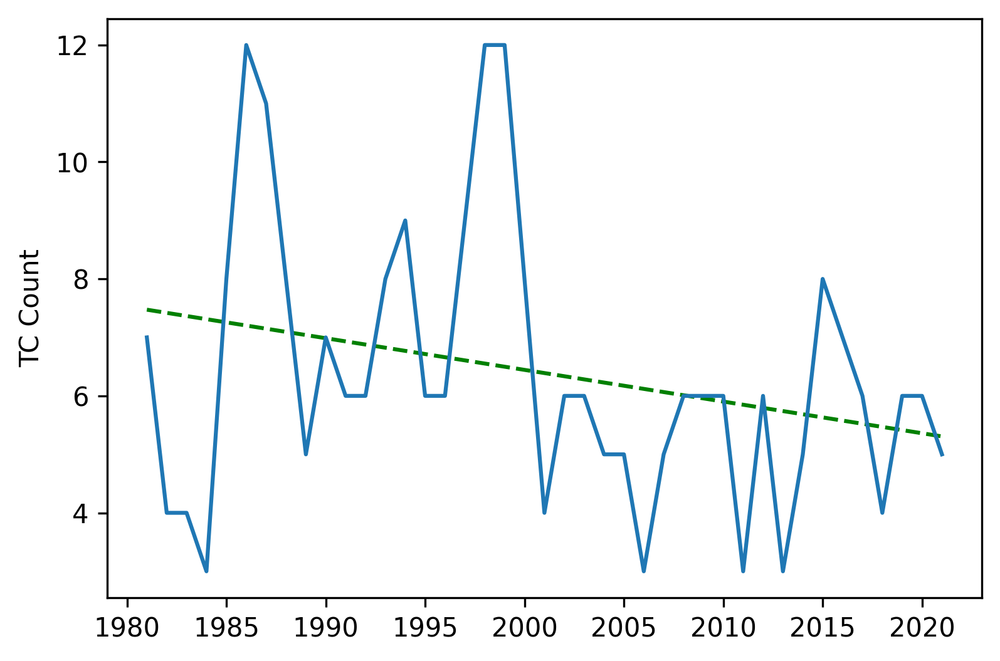

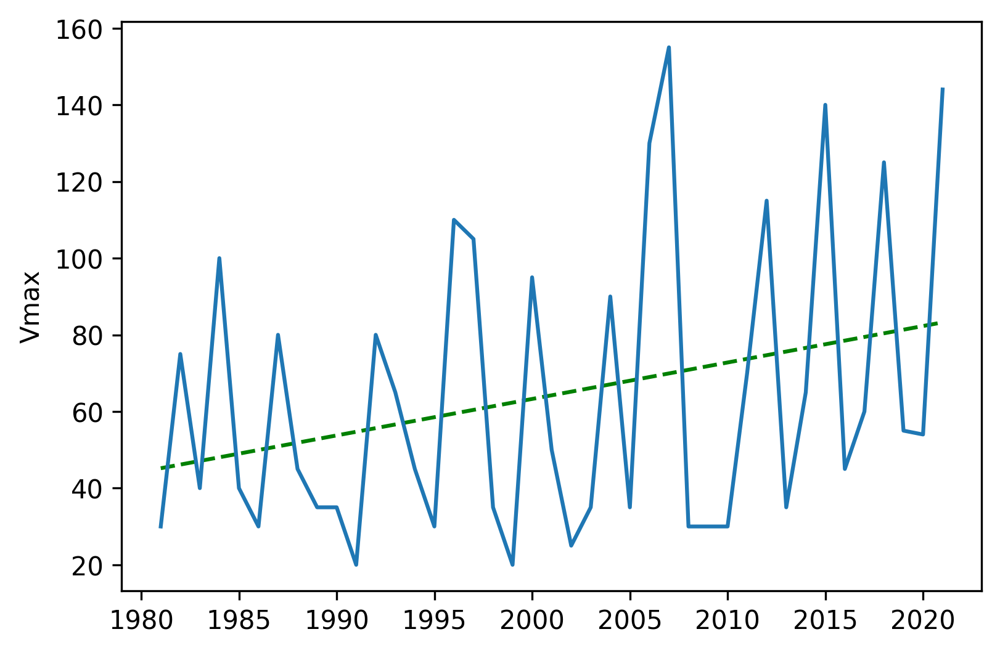

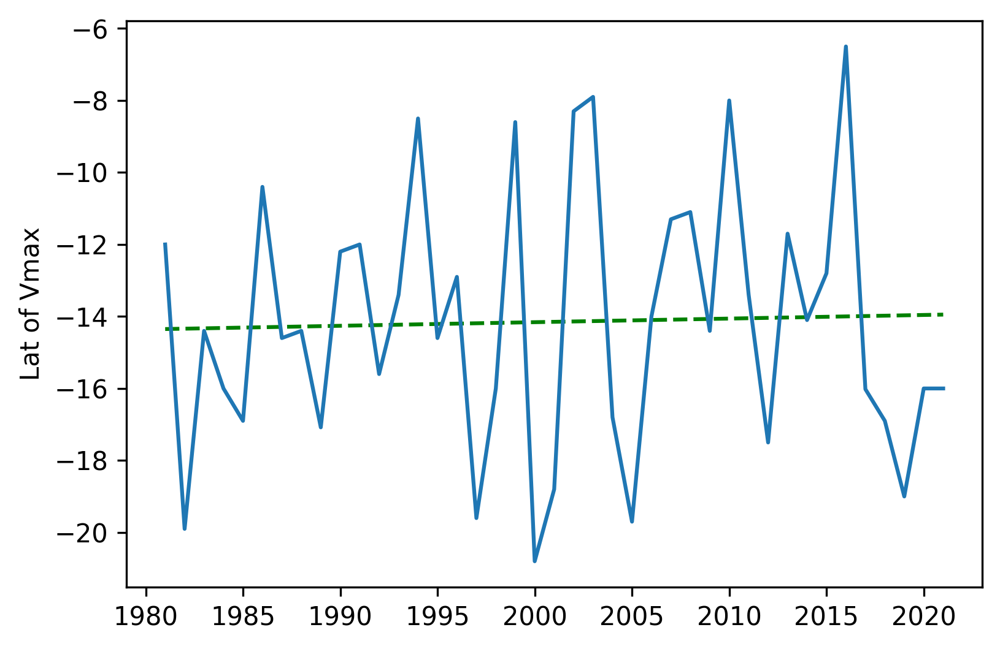

In [11]:
# OZ
lon_s = 135
lon_e = 170
lat_s = -45
lat_e = -5

lon_cen = (lon_s+lon_e)*0.5
proj    = ccrs.PlateCarree(central_longitude=lon_cen)
extent = [lon_s, lon_e, lat_s, lat_e]

df = rd_IB_info(year_s, year_e, extent, True)
ts_trendline(df, 'TC Count')
ts_trendline(df, 'Vmax')
ts_trendline(df, 'Lat of Vmax')

- 2.2 LENS2 HR 10 member

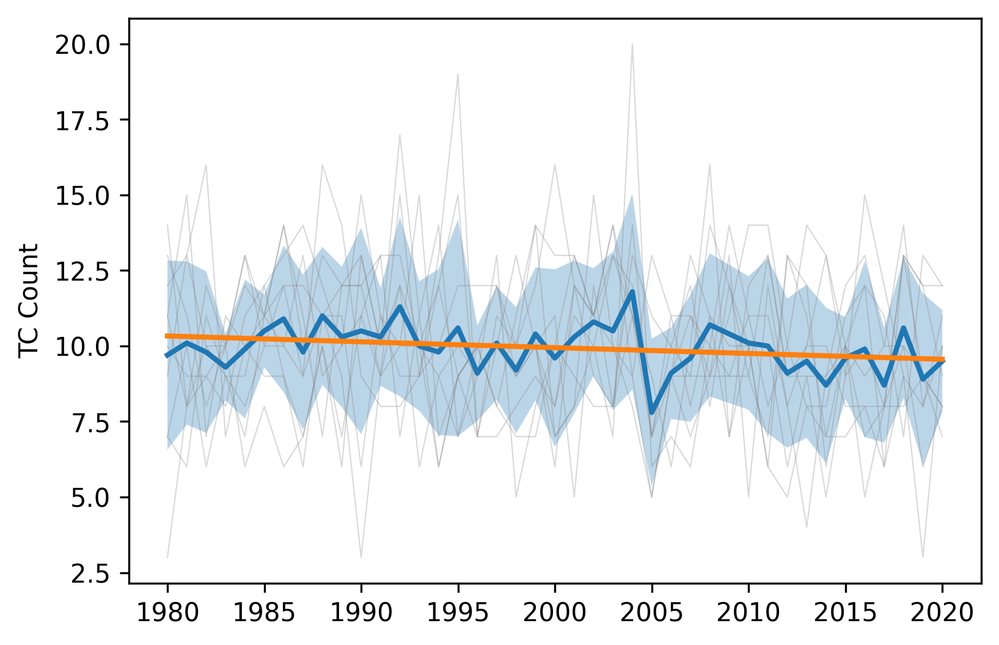

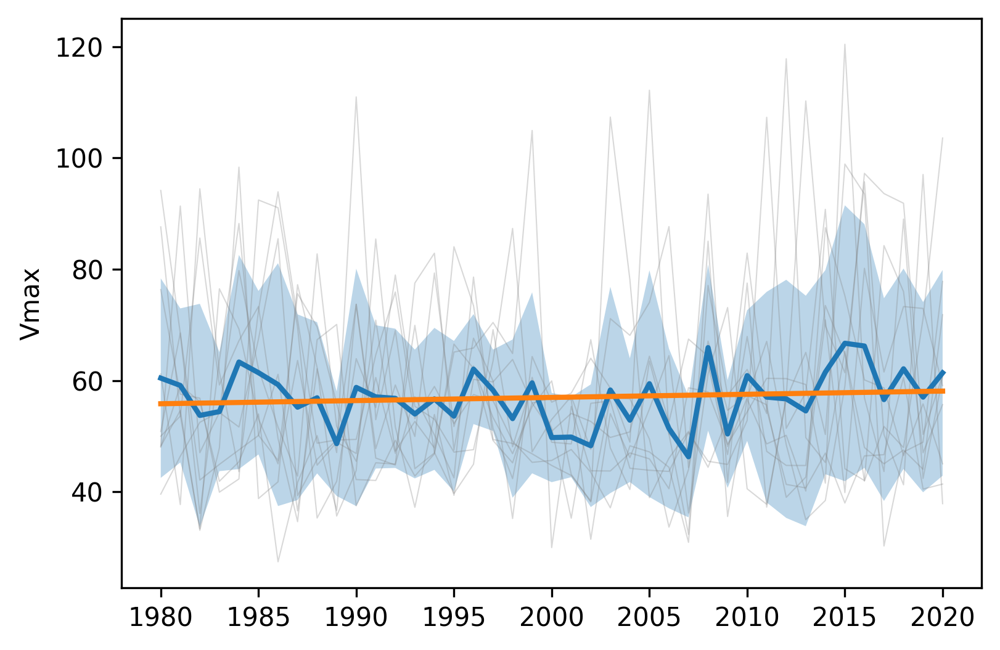

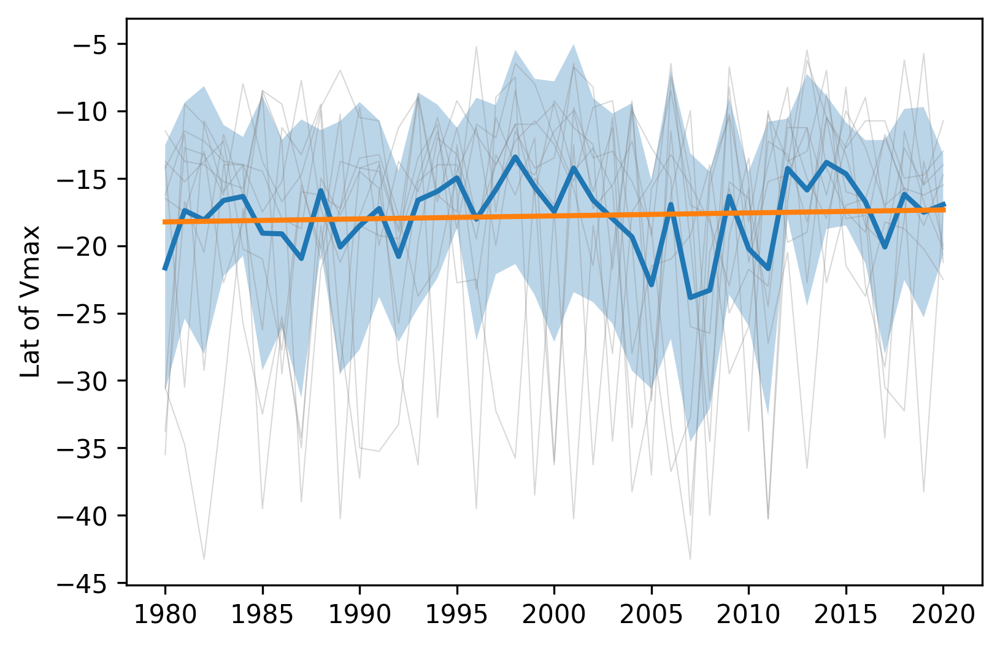

In [12]:
data_3d = rd_HR_info(dir_hr, year_s, year_e, extent) 
ts_trendline_en(year_s, year_e, data_3d)

- 2.3 LENS2 WeakThreshold 100 member

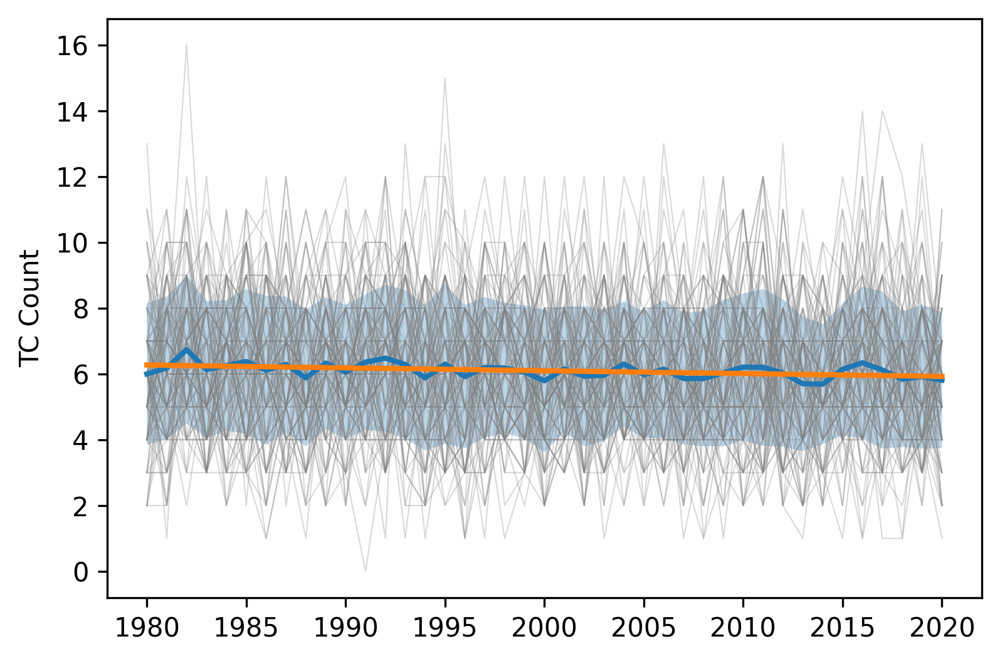

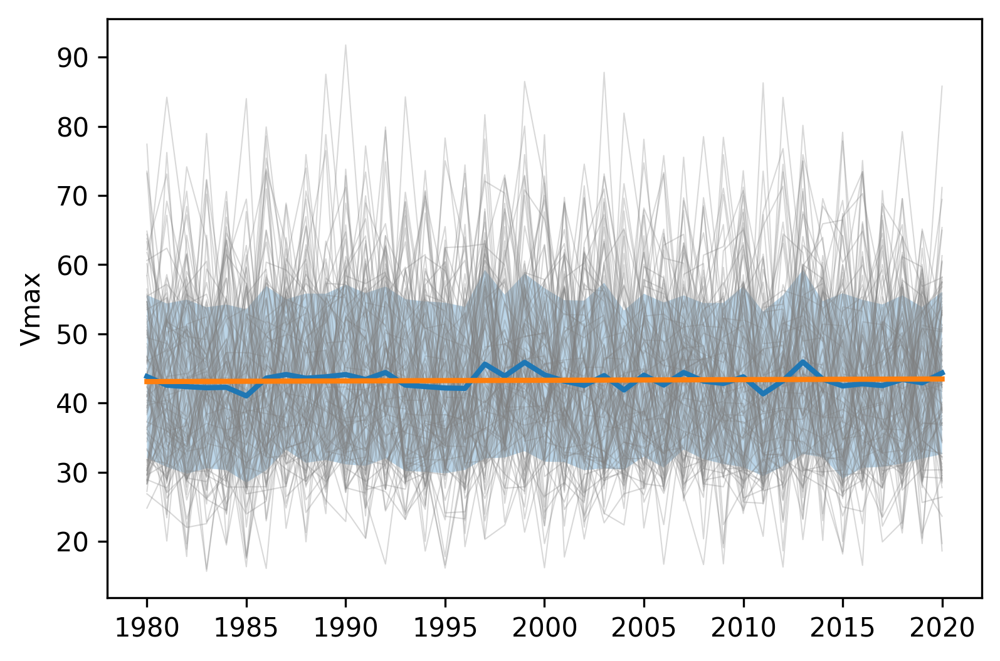

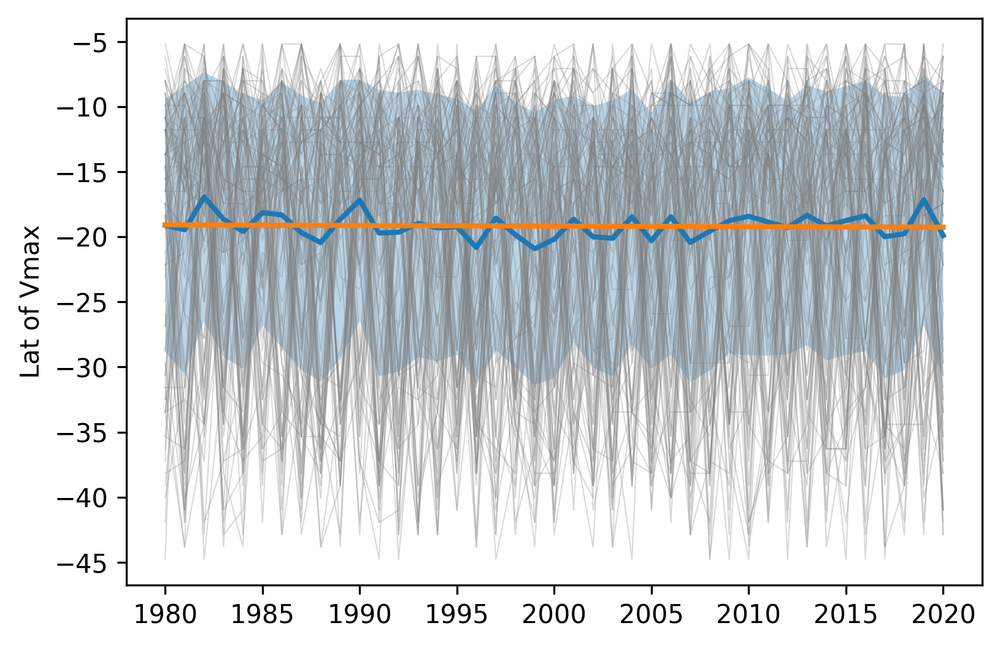

In [13]:
data_3d = rd_LENS2_info(dir_lens2, year_s, year_e, extent)
ts_trendline_en(year_s, year_e, data_3d)

#### 3 West Australia
- 3.1 IBTrACS

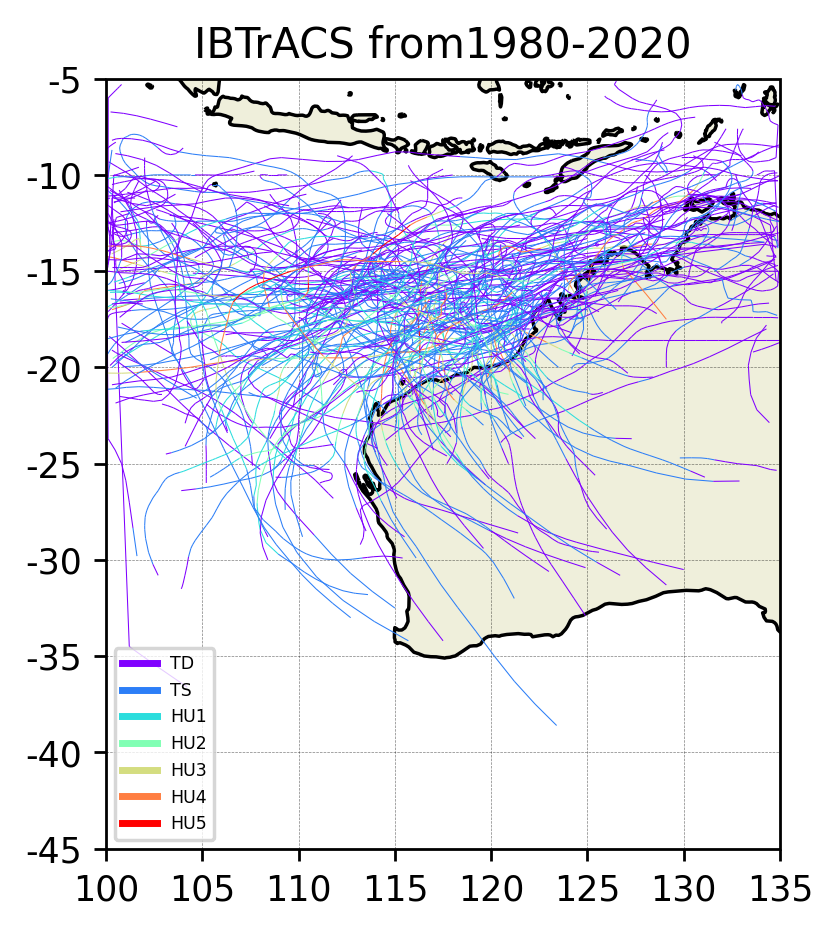

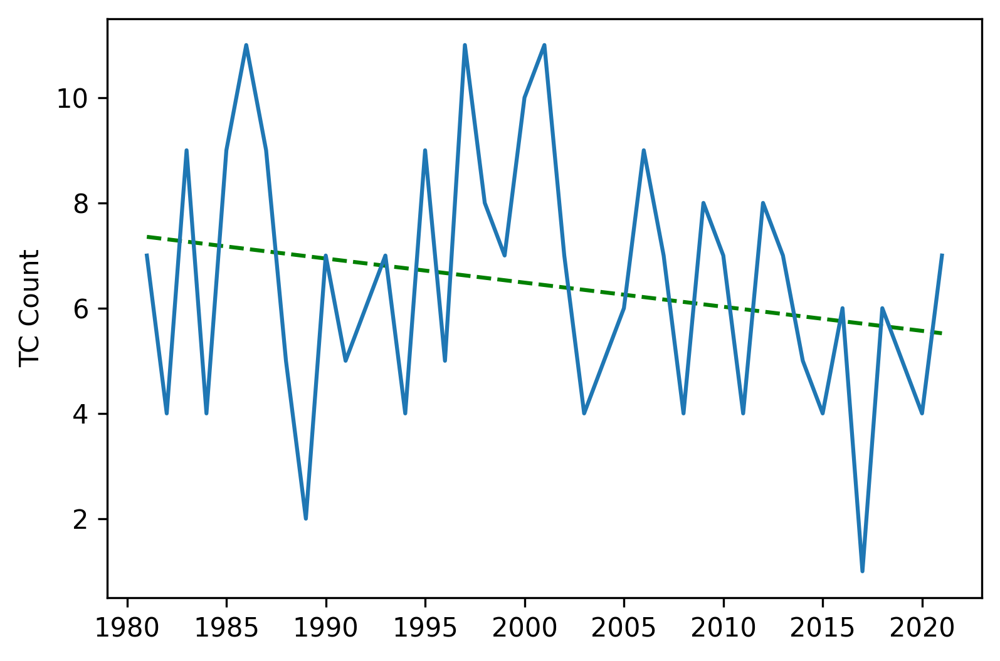

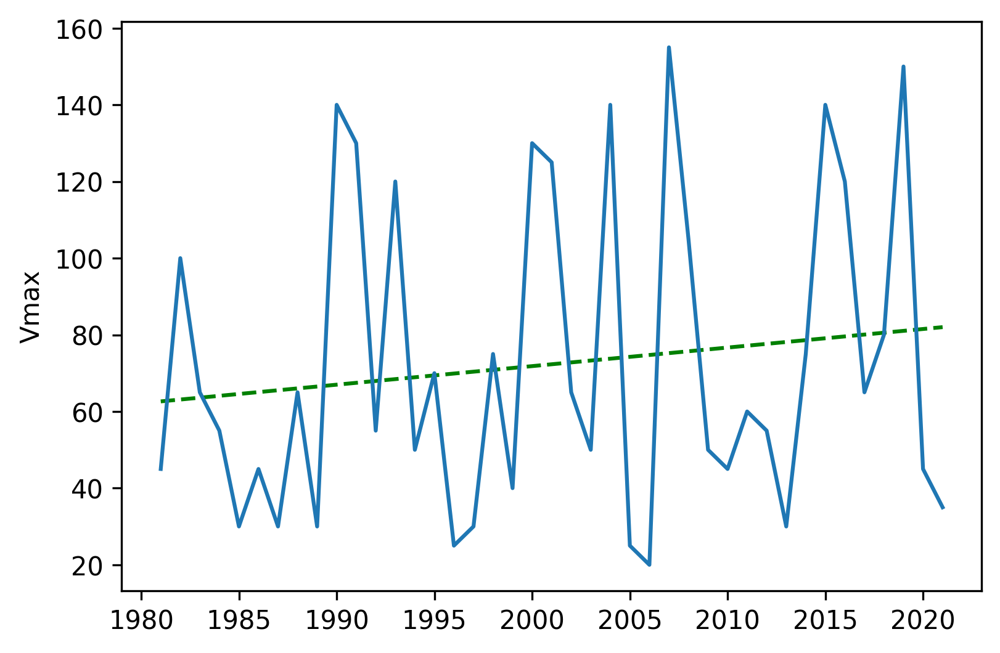

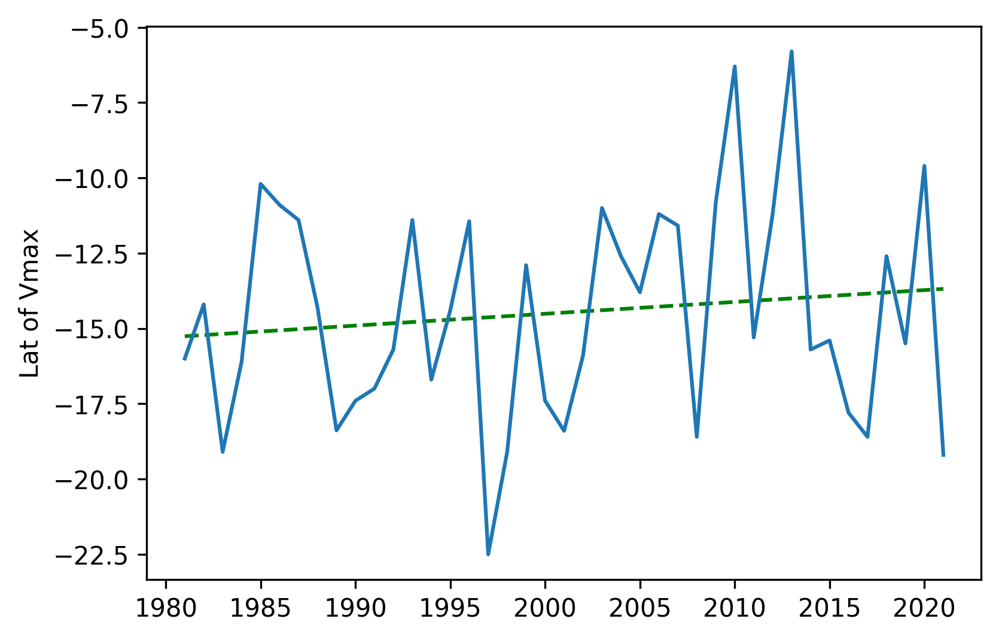

In [14]:
lon_s = 100
lon_e = 135
lat_s = -45
lat_e = -5

lon_cen = (lon_s+lon_e)*0.5
proj    = ccrs.PlateCarree(central_longitude=lon_cen)
extent = [lon_s, lon_e, lat_s, lat_e]

df = rd_IB_info(year_s, year_e, extent, True)
ts_trendline(df, 'TC Count')
ts_trendline(df, 'Vmax')
ts_trendline(df, 'Lat of Vmax')

- 3.2 LENS2 HR

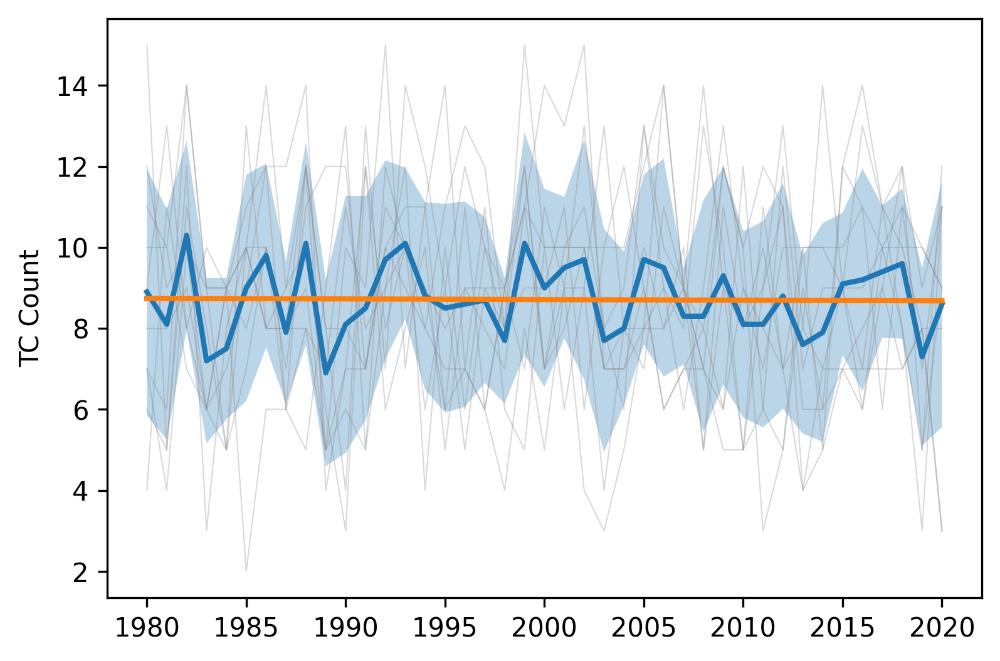

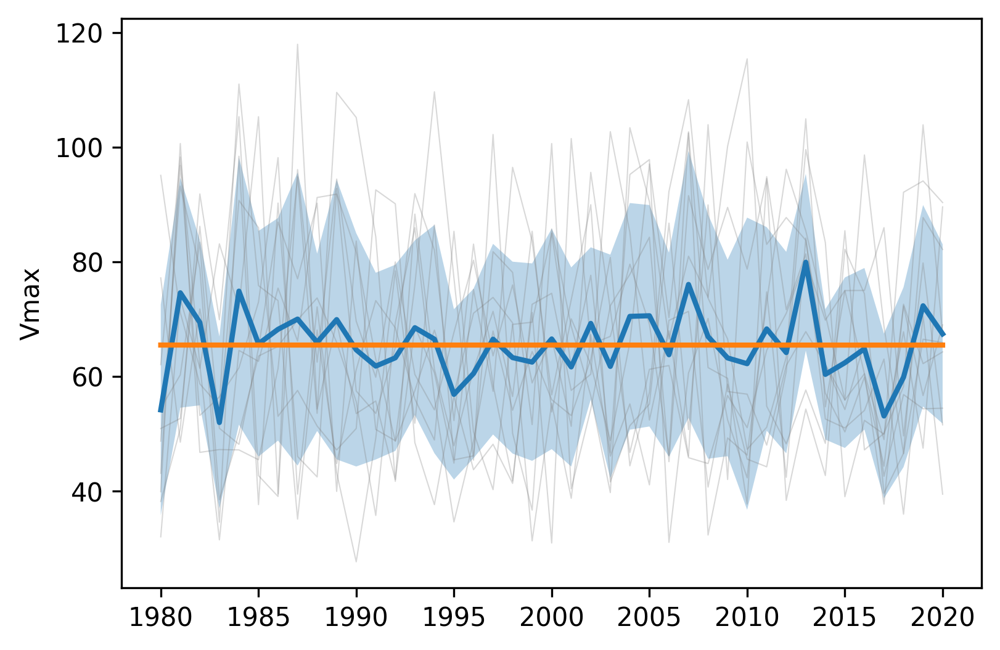

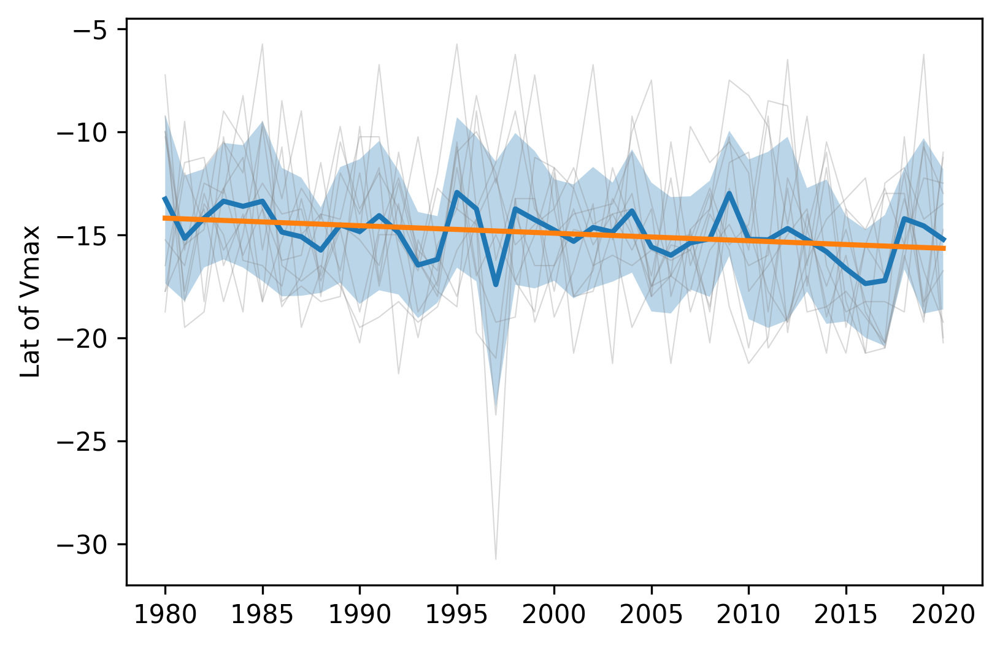

In [15]:
data_3d = rd_HR_info(dir_hr, year_s, year_e, extent) 
ts_trendline_en(year_s, year_e, data_3d) 

- 3.3 LENS2 WeakThreshold 100 member

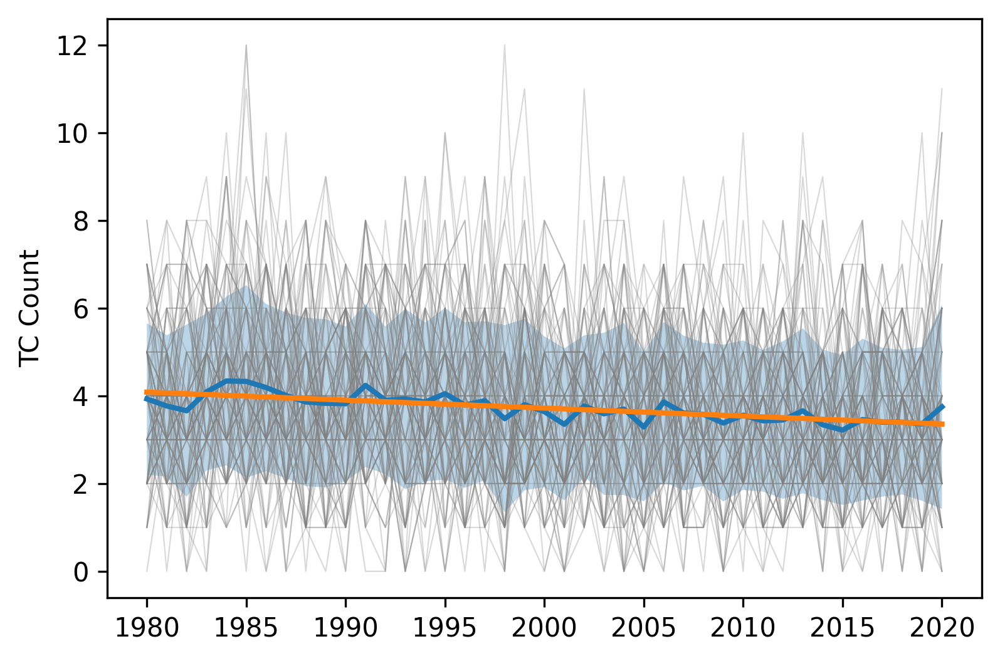

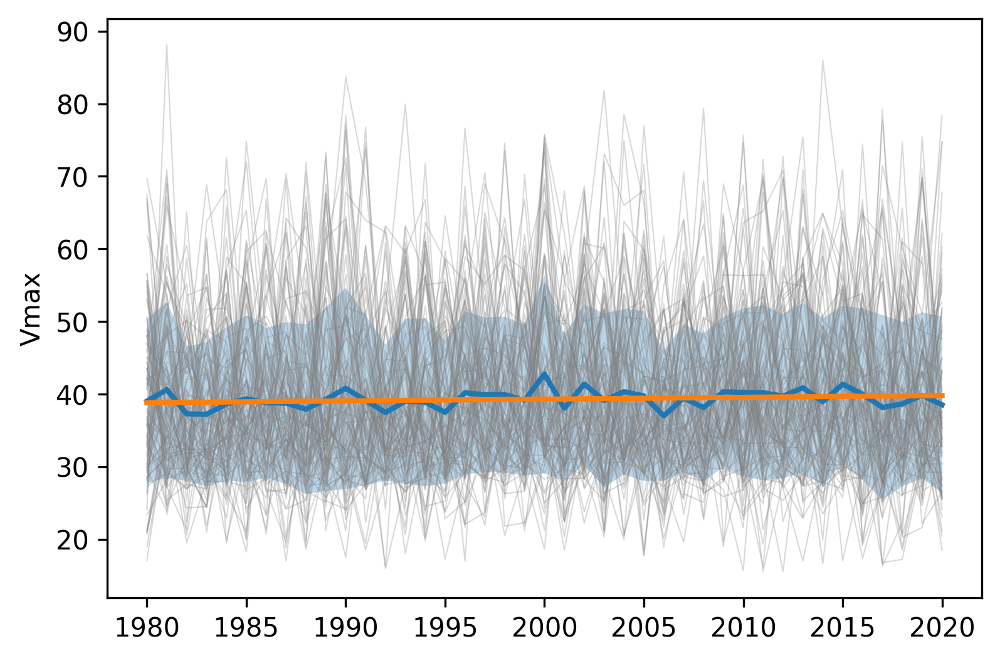

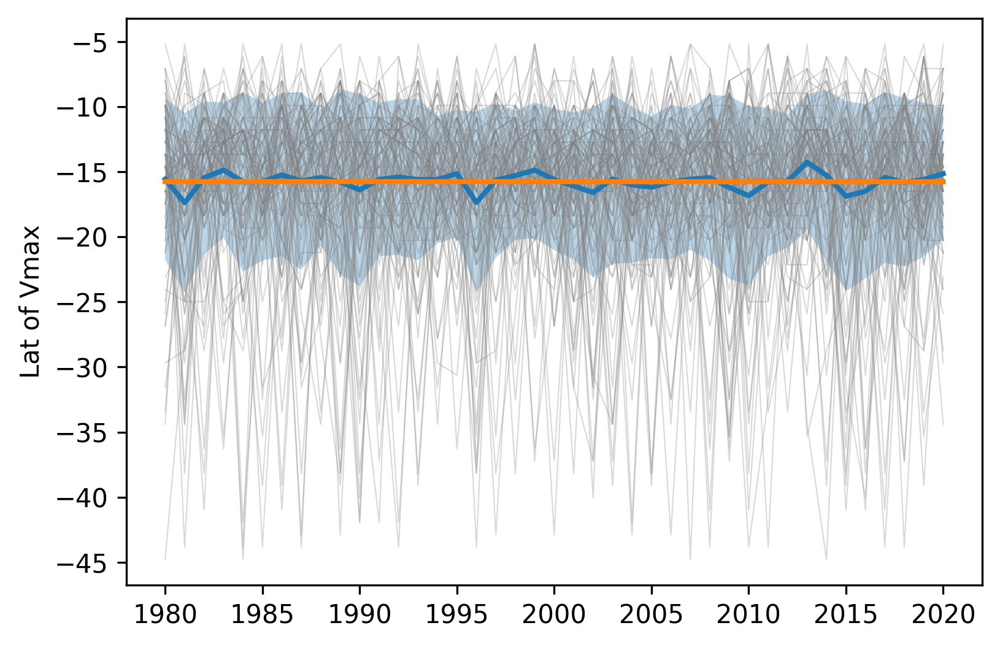

In [16]:
data_3d = rd_LENS2_info(dir_lens2, year_s, year_e, extent)
ts_trendline_en(year_s, year_e, data_3d)

#### 4 New Zeland
- 4.1 IBTrACS

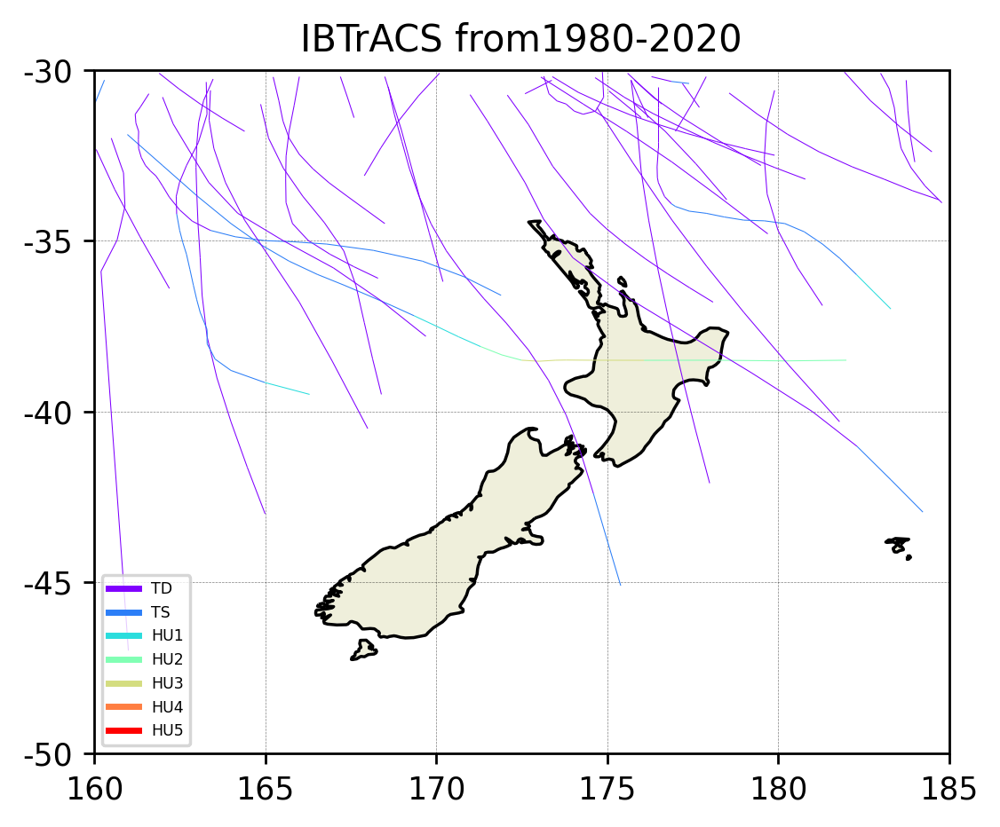

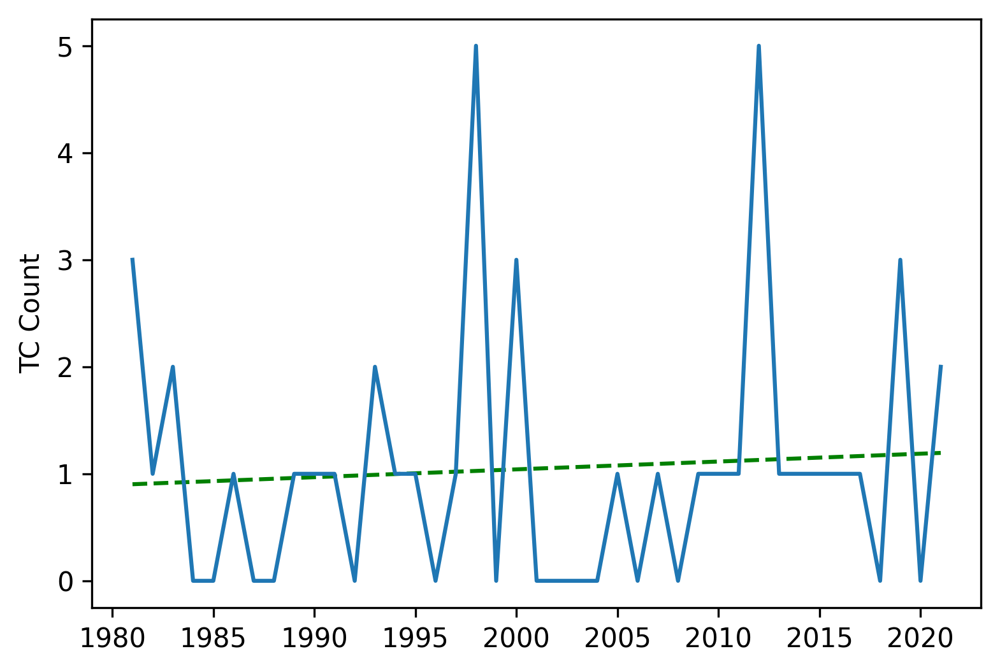

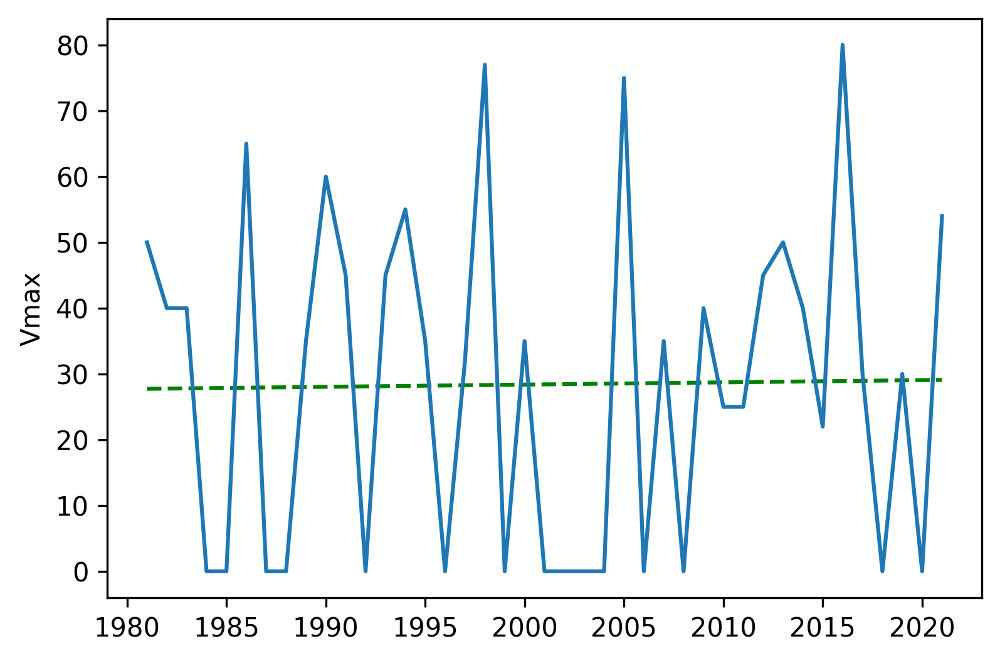

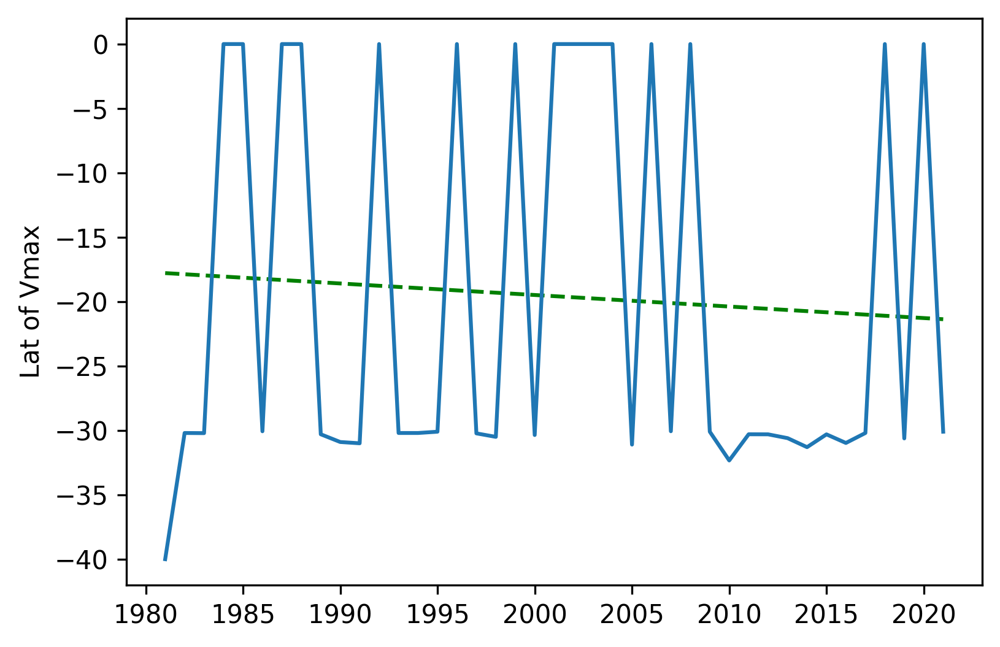

In [17]:
lon_s = 160
lon_e = 185
lat_s = -50
lat_e = -30

lon_cen = (lon_s+lon_e)*0.5
proj    = ccrs.PlateCarree(central_longitude=lon_cen)
extent = [lon_s, lon_e, lat_s, lat_e]

df = rd_IB_info(year_s, year_e, extent, True)
ts_trendline(df, 'TC Count')
ts_trendline(df, 'Vmax')
ts_trendline(df, 'Lat of Vmax')

- 4.2 LENS HR 10 member

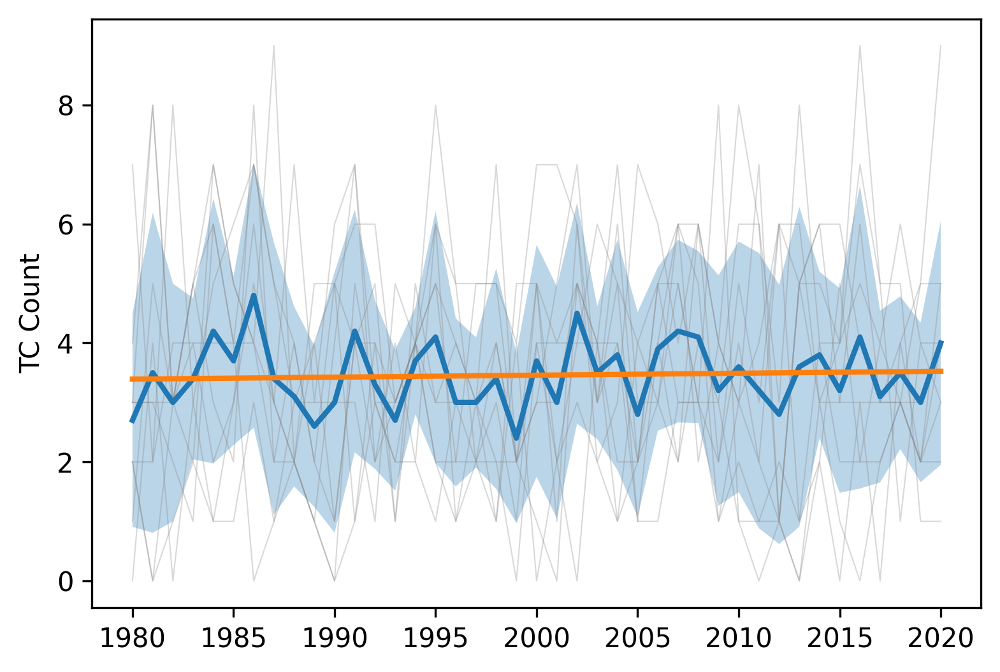

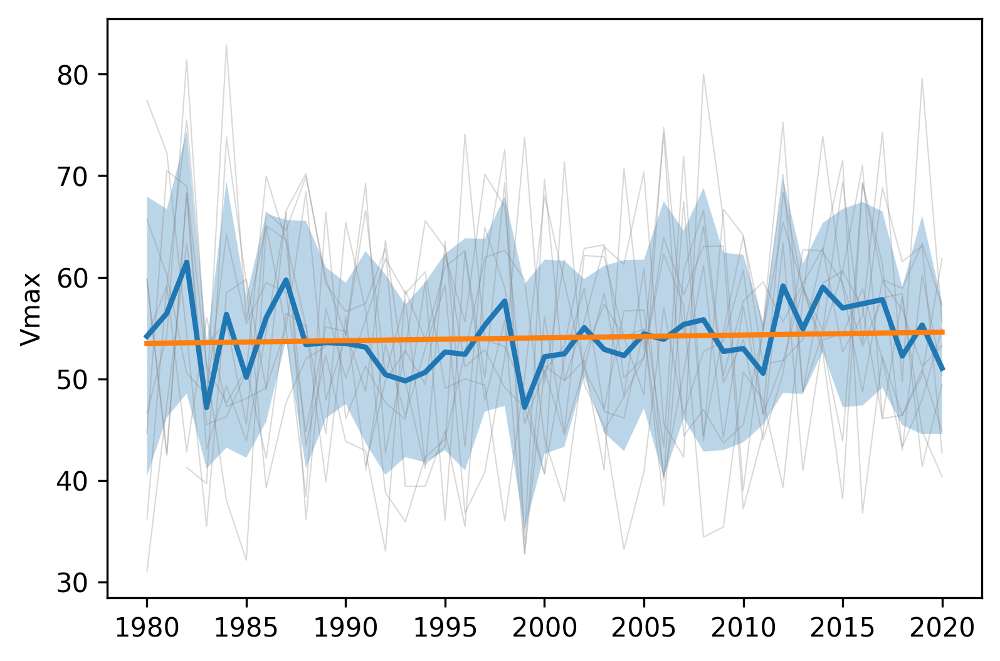

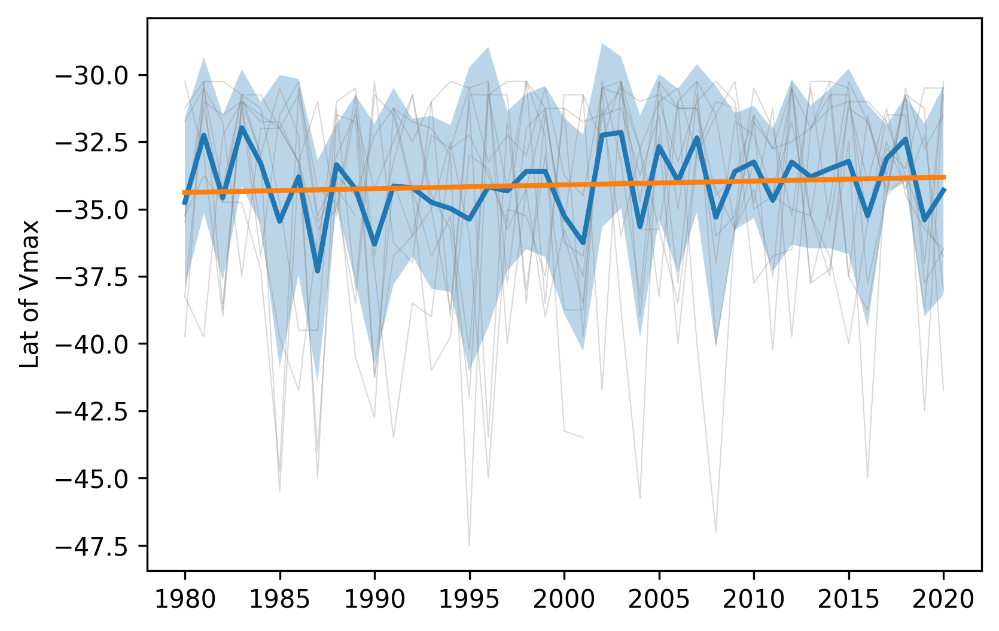

In [18]:
data_3d = rd_HR_info(dir_hr, year_s, year_e, extent) 
ts_trendline_en(year_s, year_e, data_3d) 

- 4.3 WeakThreshold 100 member

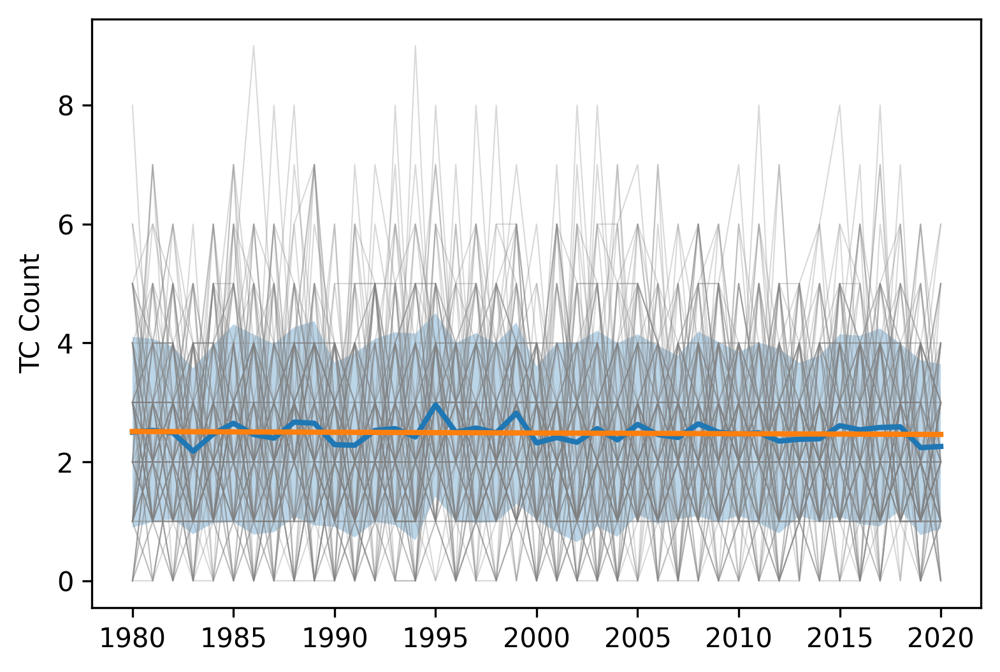

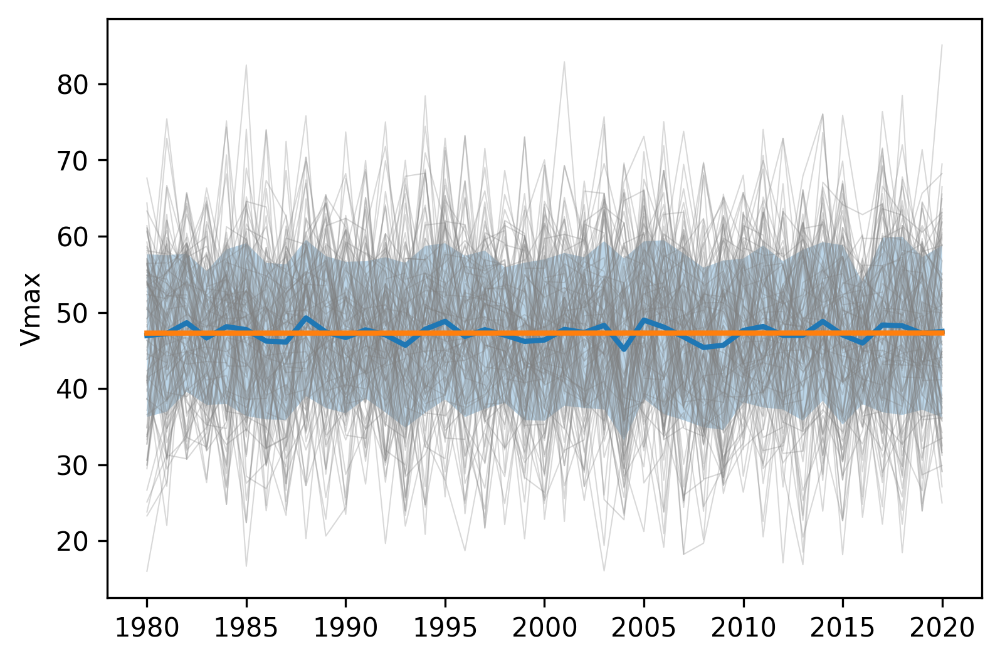

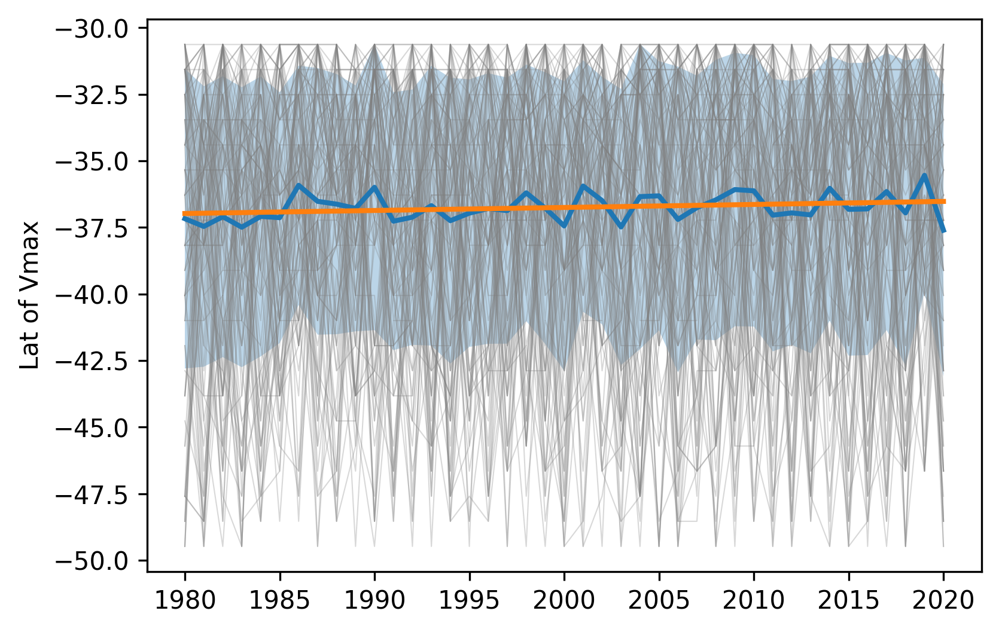

In [19]:
data_3d = rd_LENS2_info(dir_lens2, year_s, year_e, extent)
ts_trendline_en(year_s, year_e, data_3d) 